In [9]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
train = pd.read_csv('./seti-breakthrough-listen/train_labels.csv')
print('Train shape is', train.shape )
train.head()

train['img_path']=train['id'].apply(lambda x:f'./seti-breakthrough-listen/train/{x[0]}/{x}.npy')
train.head()

Train shape is (60000, 2)


,id,target,img_path
0,0000799a2b2c42d,0,./seti-breakthrough-listen/train/0/0000799a2b2...
1,00042890562ff68,0,./seti-breakthrough-listen/train/0/00042890562...
2,0005364cdcb8e5b,0,./seti-breakthrough-listen/train/0/0005364cdcb...
3,0007a5a46901c56,0,./seti-breakthrough-listen/train/0/0007a5a4690...
4,0009283e145448e,0,./seti-breakthrough-listen/train/0/0009283e145...


In [10]:
def drawCadence (dataset, reading):
    figure = plt.figure(figsize=(20,10))
    reading = np.take(reading, [0,2,4], 0)
    for i in range(3):
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(reading[i].astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["ON"], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()
def deviation_cadence (dataset, reading):

    figure = plt.figure(figsize=(30, 15))
    reading = np.take(reading, [0,2,4], 0)
    for i in range(3):
        cadence = reading[i][0:256]
        cadence = cadence.T
        for j in range(len(cadence)):
            for k in range(len(cadence[j])-1):
                cadence[j][k] = abs(cadence[j][k] - cadence[j][k+1])

        cadence =cadence.T
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(cadence.astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["ON", "OFF"][i % 2], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()

def deviation_cadence_horizontal (dataset, reading):

    figure = plt.figure(figsize=(30, 15))
    reading = np.take(reading, [0,2,4], 0)
    for i in range(3):
        cadence = reading[i][0:256]
        cadence = cadence.T
        for j in range(len(cadence)-1):
            for k in range(len(cadence[j])):
                cadence[j][k] = abs(cadence[j][k] - cadence[j+1][k])

        cadence =cadence.T
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(cadence.astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["ON", "OFF"][i % 2], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()

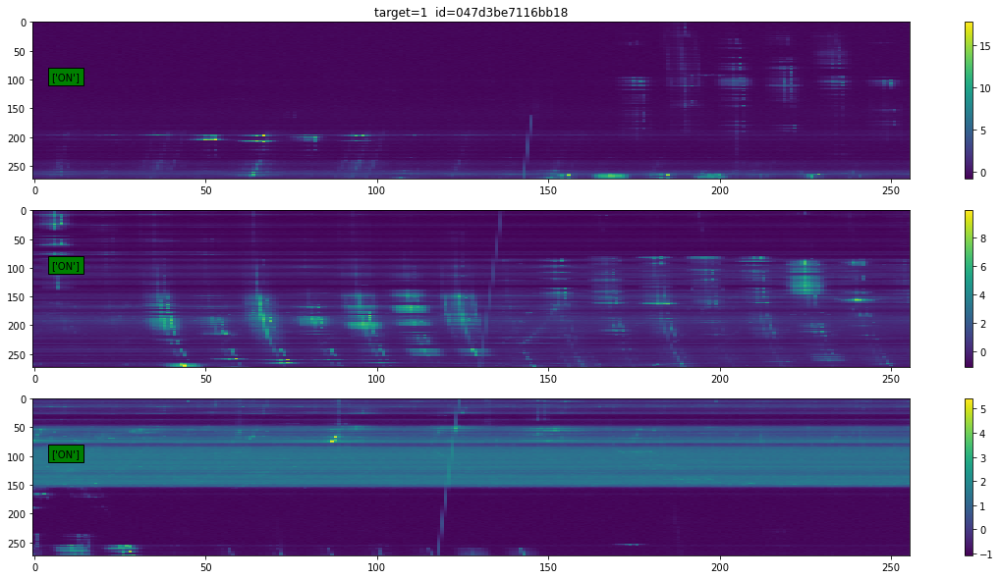

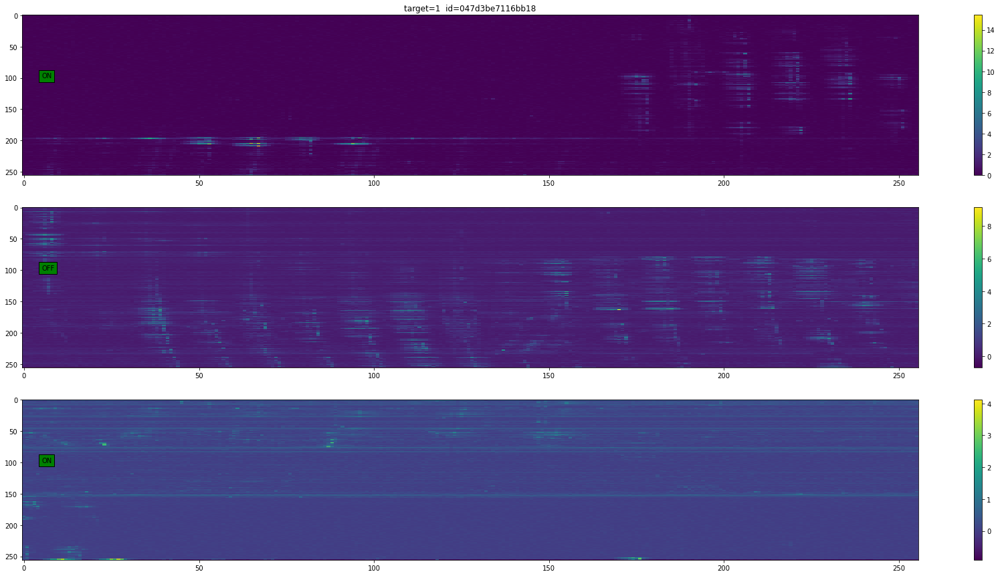

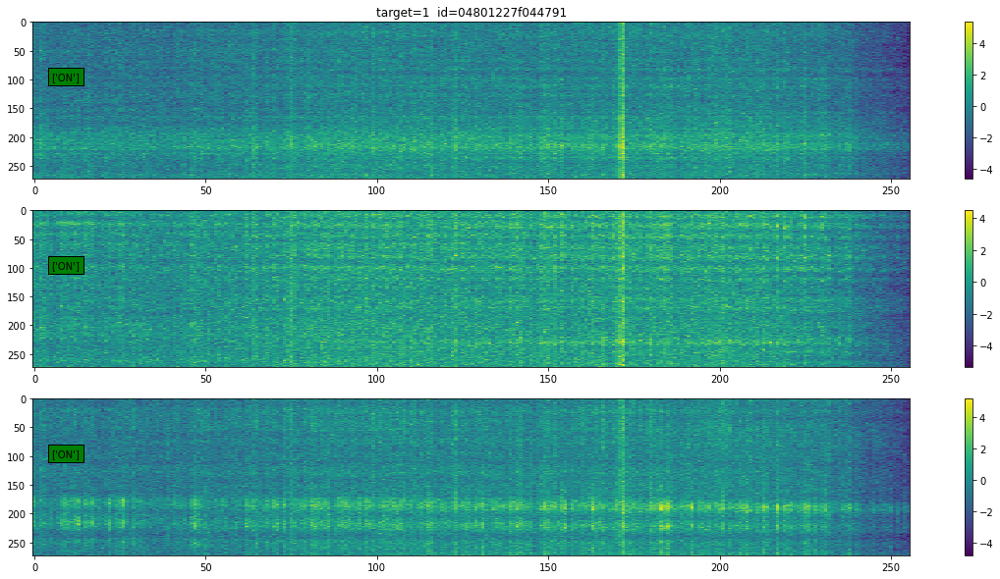

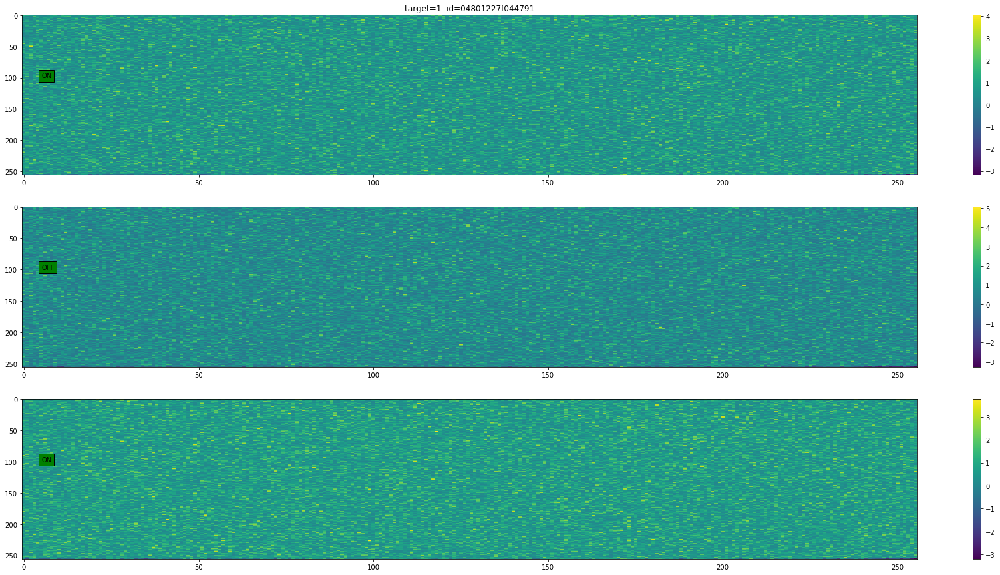

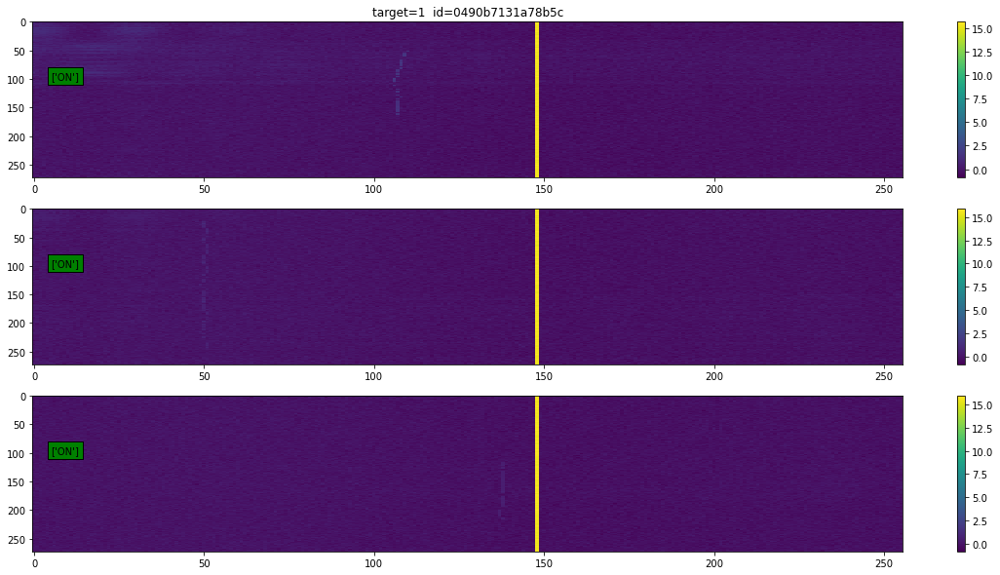

...

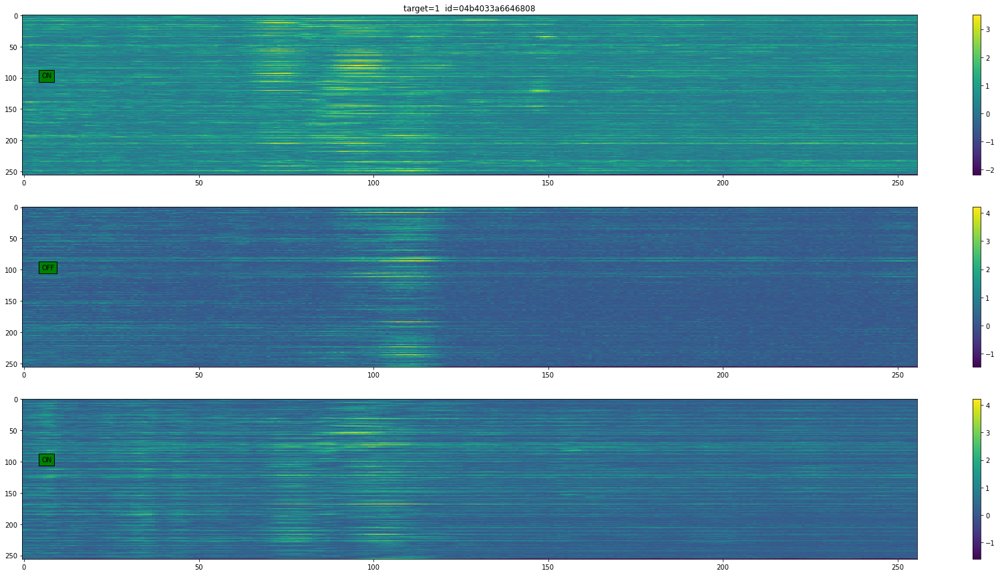

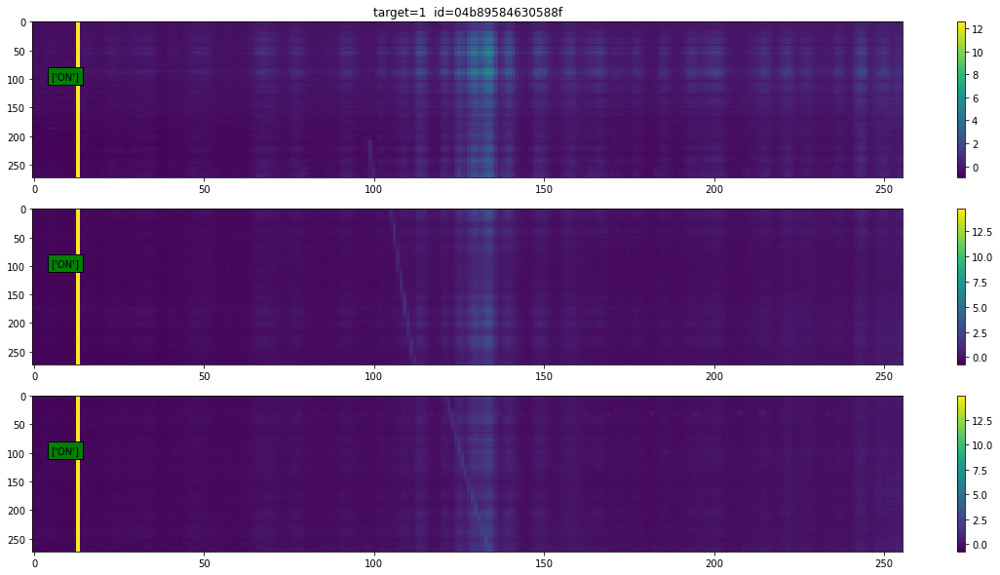

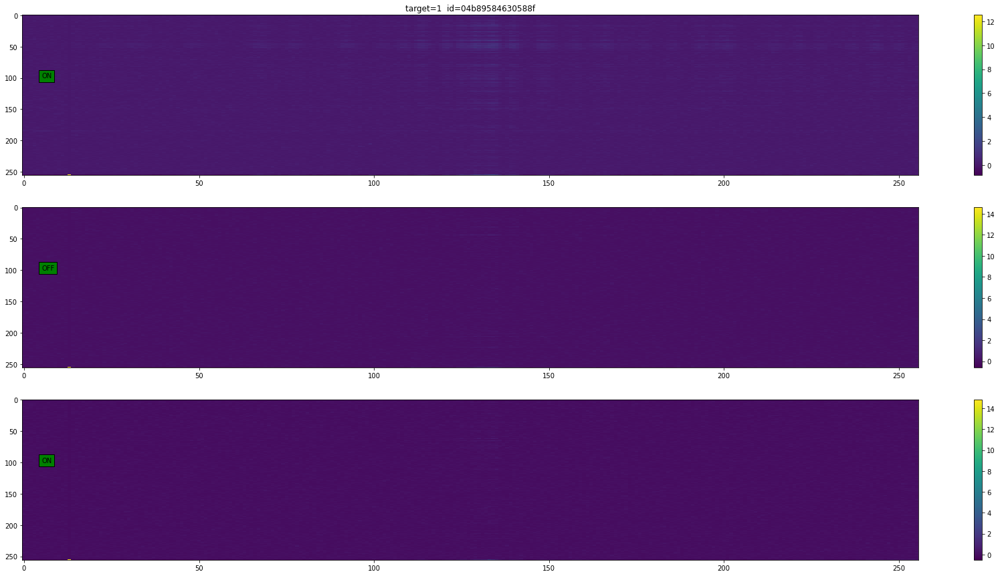

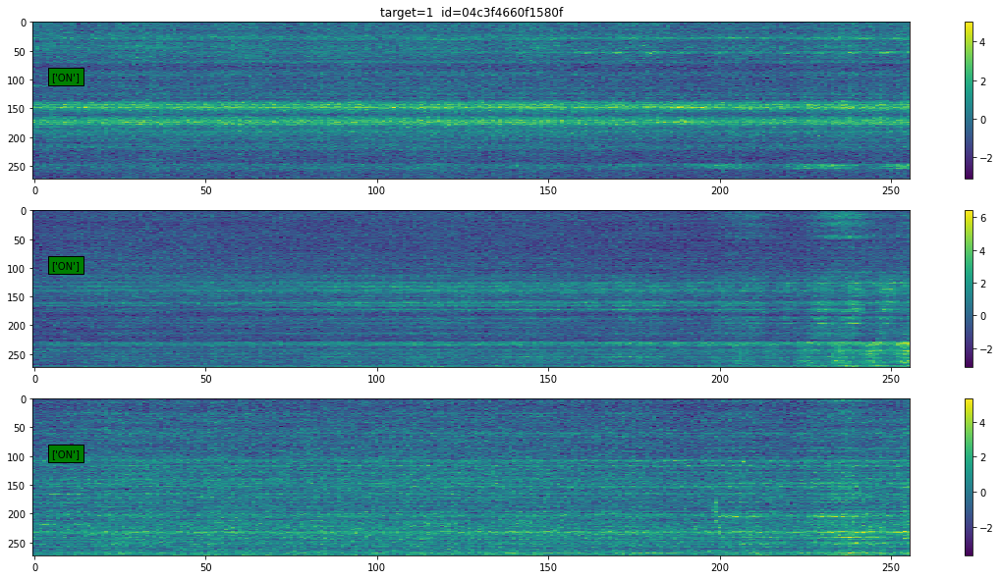

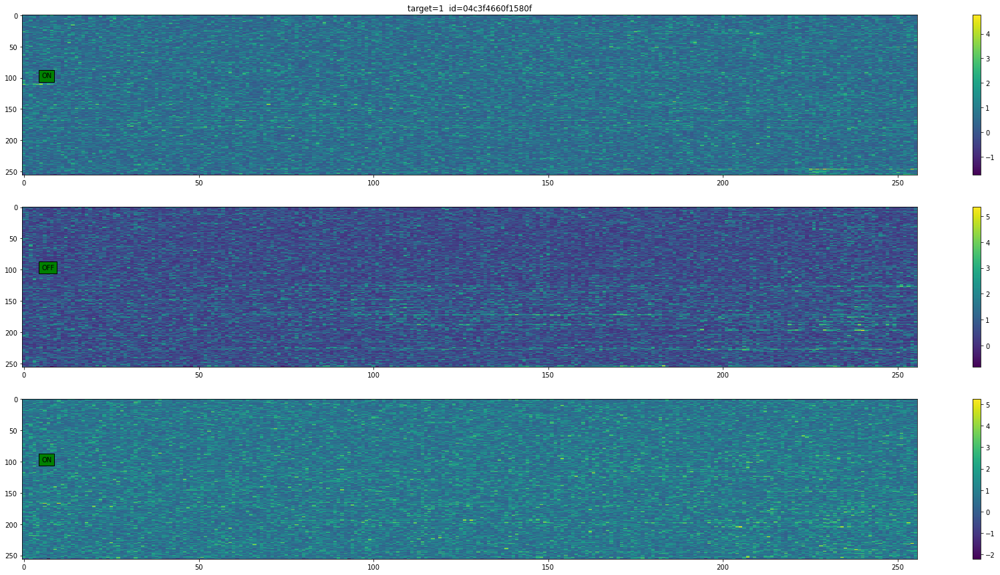

In [11]:
for i in range(100,110):
    entry = train.loc[train['target'] == 1].iloc[i]
    drawCadence(entry, np.load(entry['img_path']))
    deviation_cadence(entry, np.load(entry['img_path']))

In [12]:
reading = np.load(entry['img_path'])
test = np.take(reading, [0,2,4], 0)
print(test.shape)
print(len(test[0]))
print(len(test[0][0]))

(3, 273, 256)
273
256


existiert ein punkt unterhalb oder links oder rechts mit delta 20% energie -> Markieren

def
use point
search right and bottom.
if found delta < limit add to point
else start new group


In [13]:
def cluster(cadence, currentCluster, right, bottom, margin, stride):
    pointFound = False
    if (bottom > len(cadence[0])-1-stride-30):
        return
    elif (right > len(cadence)-1-stride-30):
        return
    else:
        currentPoint = cadence[bottom][right]
        if currentPoint >= cadence[right-stride][bottom+stride] * (1-margin) and currentPoint <= cadence[right-stride][bottom-stride] * (1+margin):
            currentCluster.append(tuple((right-stride, bottom+stride)))
            pointFound = True
            cluster(cadence, currentCluster, right-stride, bottom+stride, margin, stride)
        if currentPoint >= cadence[right][bottom+stride] * (1-margin) and currentPoint <= cadence[right][bottom+stride] * (1+margin):
            currentCluster.append(tuple((right, bottom+stride)))
            pointFound = True
            cluster(cadence, currentCluster, right, bottom+stride, margin, stride)
        if currentPoint >= cadence[right+stride][bottom] * (1-margin) and currentPoint <= cadence[right+stride][bottom] * (1+margin):
            currentCluster.append(tuple((right+stride, bottom)))
            pointFound = True
            cluster(cadence, currentCluster, right+stride, bottom, margin, stride)
        if currentPoint >= cadence[right+stride][bottom+stride] * (1-margin) and currentPoint <= cadence[right+stride][bottom+stride] * (1+margin):
            currentCluster.append(tuple((right+stride, bottom+stride)))
            pointFound = True
            cluster(cadence, currentCluster, right+stride, bottom+stride, margin, stride)
        # if pointFound == False:
        #     return currentCluster

#cluster in first cadence
listOfClusters = []
entry = train.loc[train['target'] == 1].iloc[7]
chosen_cadence = 0
oneCadence = np.load(entry['img_path'])[chosen_cadence]
for i in range(len(oneCadence)-1):
    for j in range(len(oneCadence[i])-1):
        currentCluster = []
        cluster(oneCadence, currentCluster, j, i, 0.1, 1)
        if len(currentCluster) > 4:
            listOfClusters.append(currentCluster)
print('Found clusters in Cadence '+str(chosen_cadence))
print(listOfClusters)

Found clusters in Cadence 0
[[(3, 4), (5, 4), (4, 5), (3, 6), (6, 5), (5, 6), (4, 7), (7, 5), (6, 6)], [(4, 5), (3, 6), (6, 5), (5, 6), (4, 7), (7, 5), (6, 6)], [(107, 9), (106, 10), (109, 8), (108, 9), (109, 9), (110, 9)], [(9, 10), (8, 11), (9, 11), (10, 11), (10, 12), (11, 12), (12, 13), (10, 10)], [(8, 11), (9, 11), (10, 11), (10, 12), (11, 12), (12, 13), (10, 10)], [(22, 10), (21, 11), (20, 12), (20, 13), (21, 13), (22, 11)], [(21, 11), (20, 12), (20, 13), (21, 13), (22, 11)], [(21, 11), (20, 12), (20, 13), (21, 13), (22, 11), (21, 12), (20, 13), (21, 13), (22, 13), (21, 14), (23, 13), (24, 13)], [(12, 13), (13, 13), (12, 14), (14, 14), (13, 15), (13, 16)], [(12, 13), (13, 13), (12, 14), (14, 14), (13, 15), (13, 16), (14, 13), (13, 14), (12, 15)], [(20, 12), (20, 13), (21, 13), (20, 13), (21, 13)], [(20, 13), (21, 13), (22, 13), (21, 14), (23, 13), (24, 13)], [(36, 14), (37, 14), (36, 15), (38, 14), (39, 14)], [(166, 14), (166, 15), (168, 14), (167, 15), (169, 14)], [(23, 15), (22

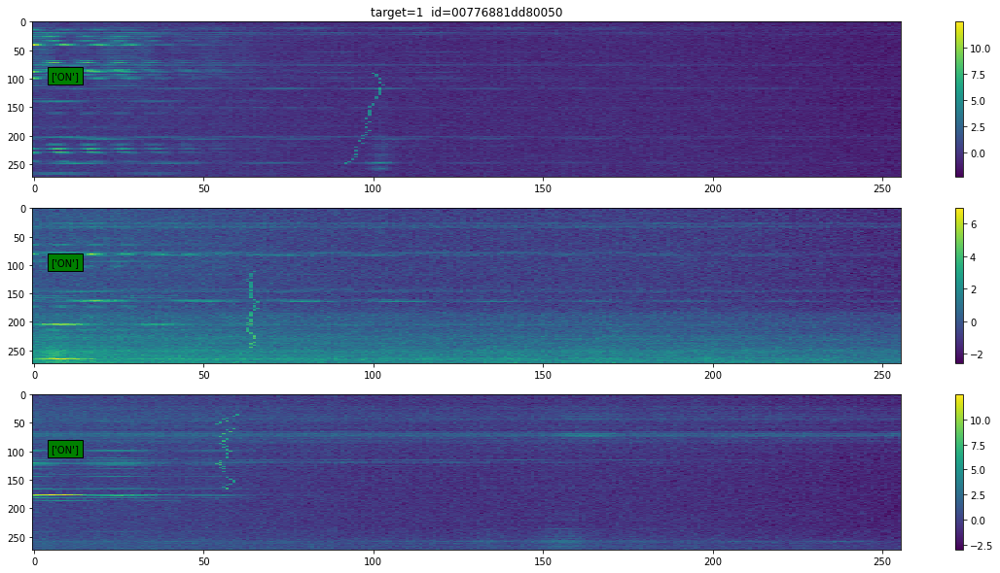

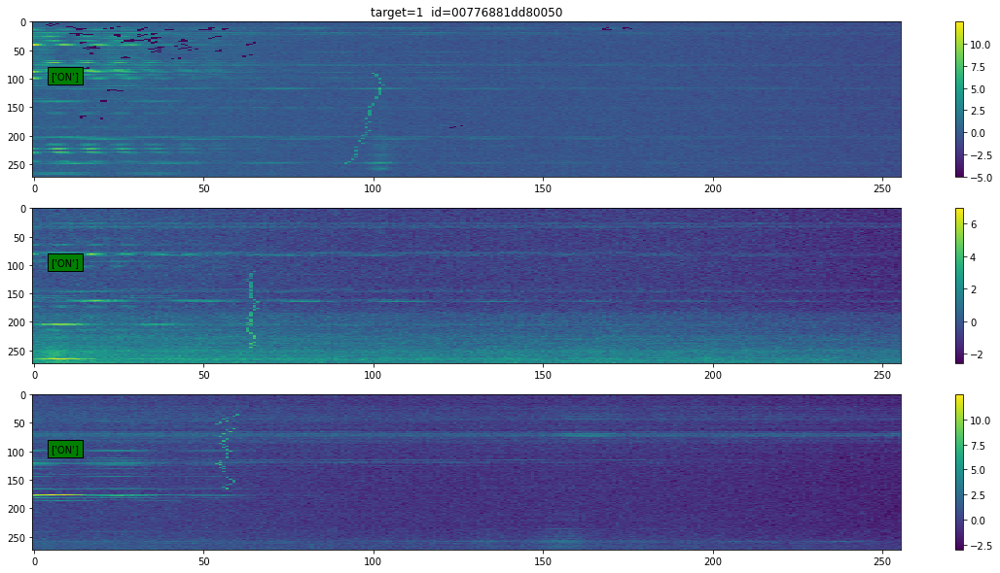

In [14]:
def fillCluster(cadence, listOfClusters):
    for i in range(len(listOfClusters)):
        for j in range(len(listOfClusters[i])):
            cadence[chosen_cadence][listOfClusters[i][j][0]][listOfClusters[i][j][1]] = -5

reading = np.load(entry['img_path'])
reading[0][0][0] = 1
drawCadence(entry, reading)
fillCluster(reading, listOfClusters)
drawCadence(entry, reading)

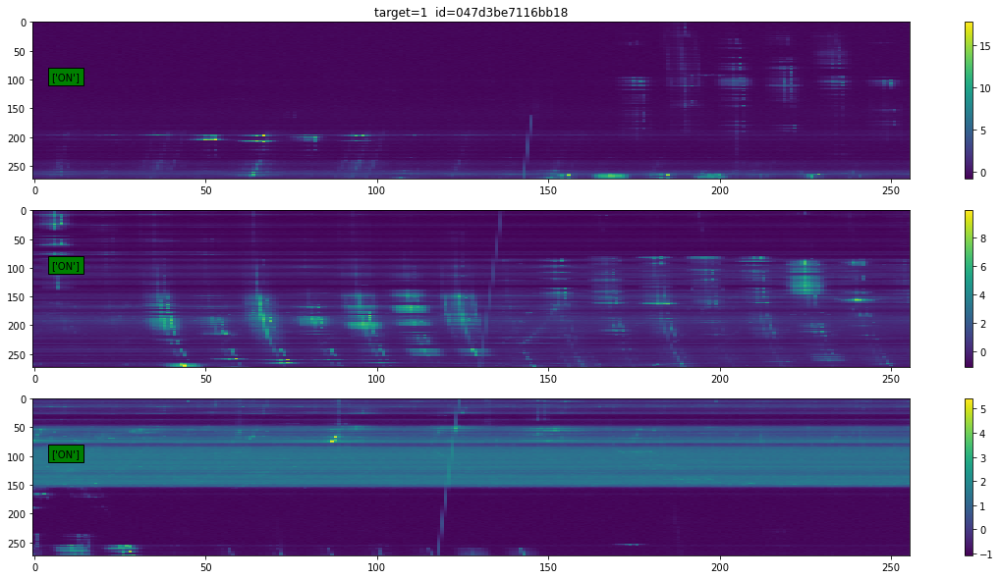

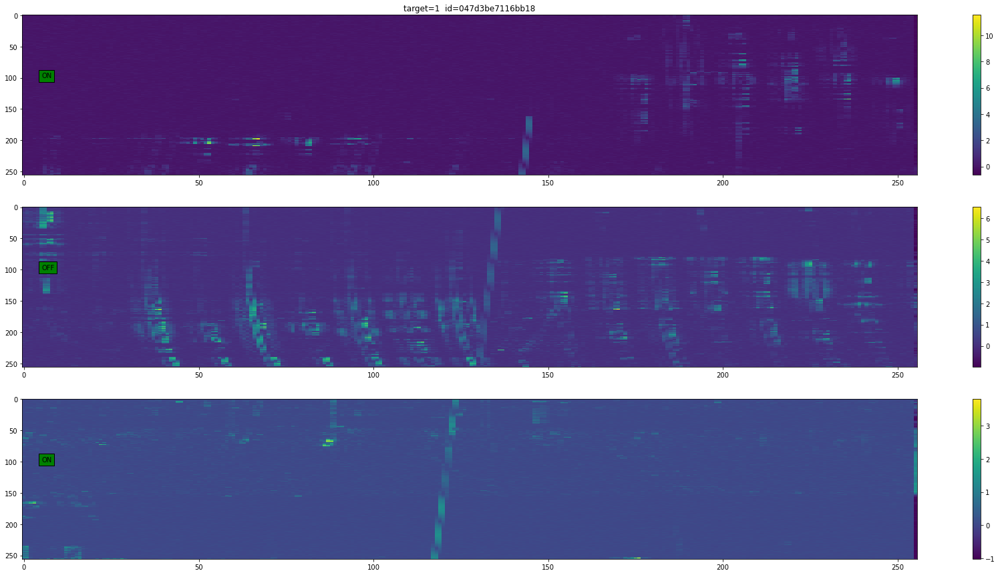

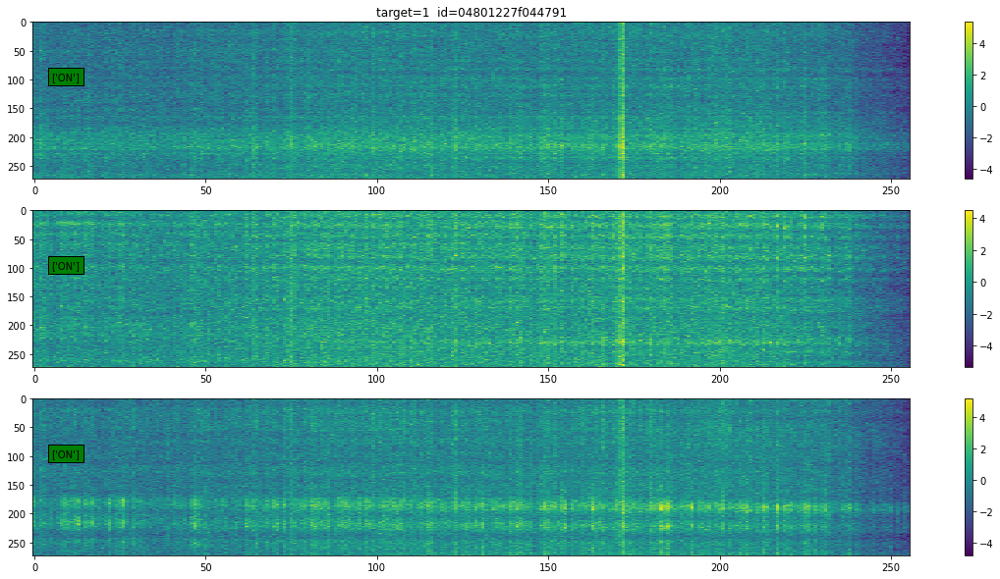

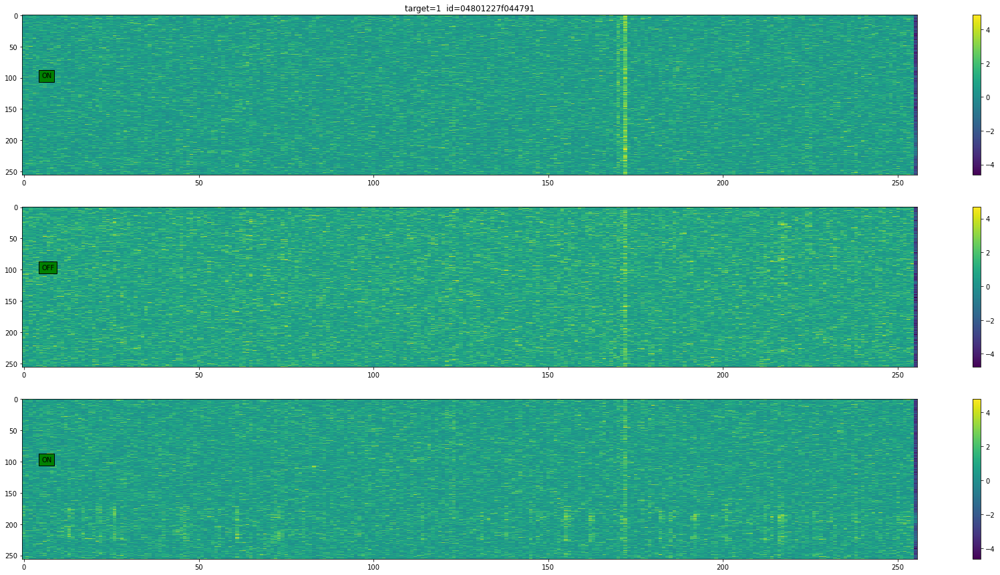

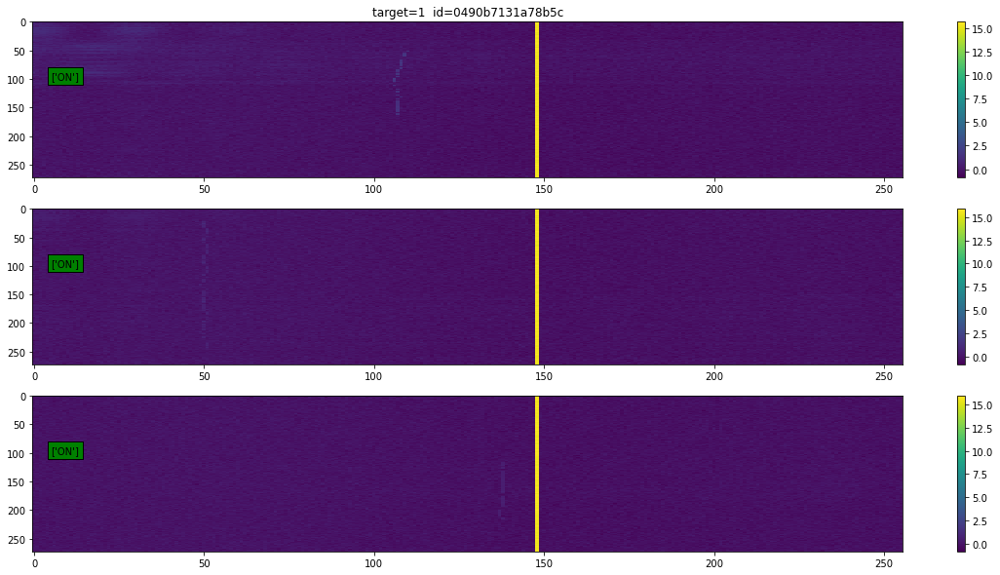

...

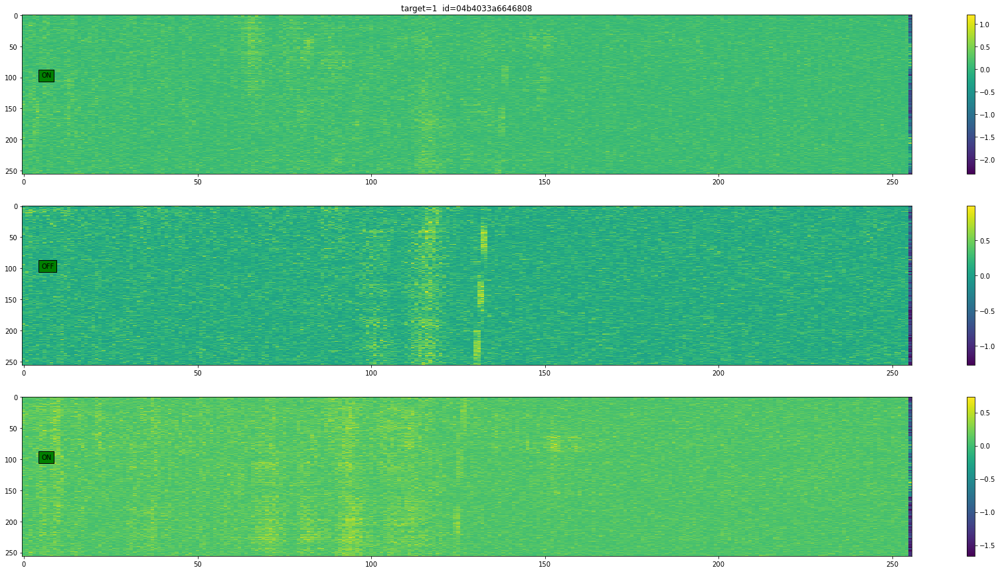

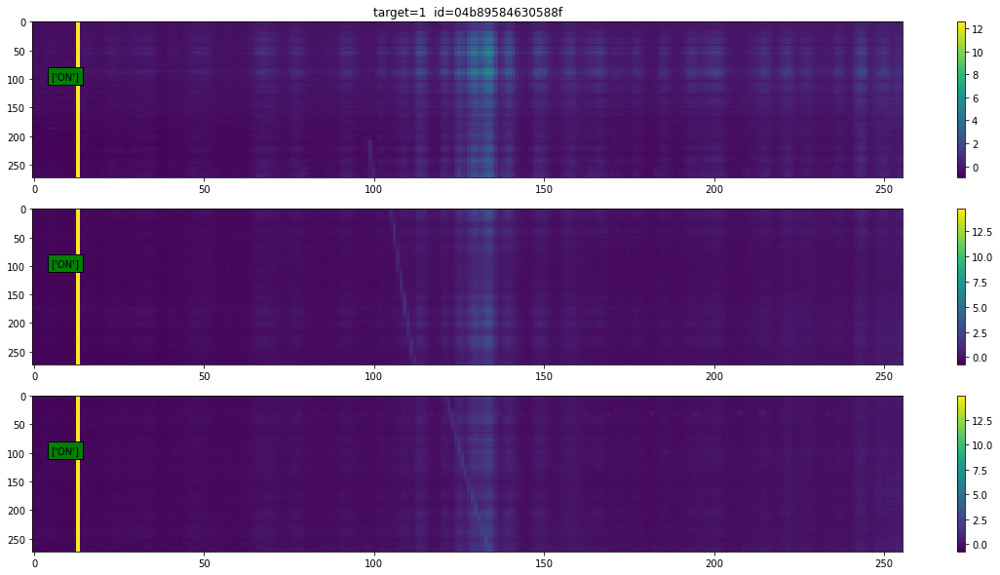

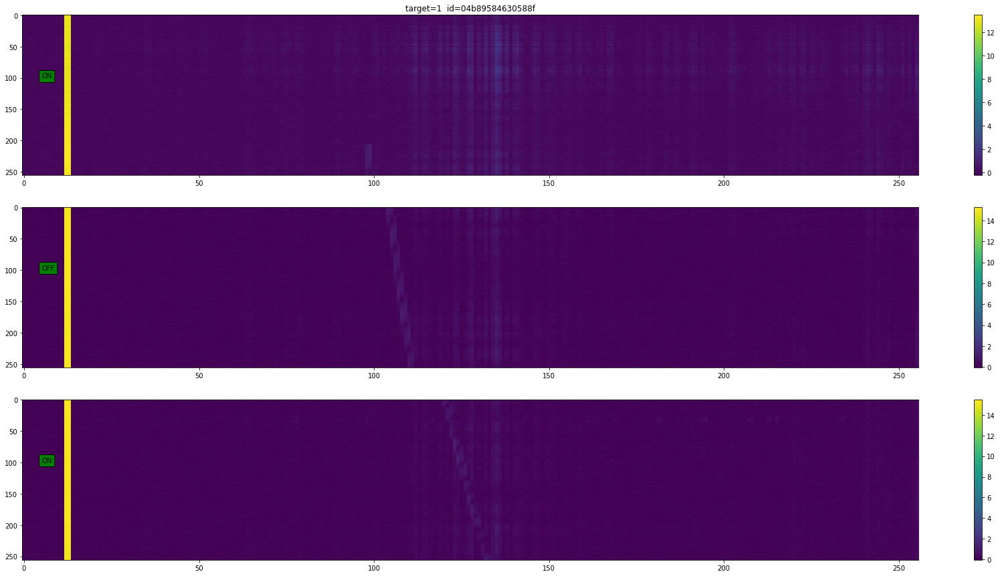

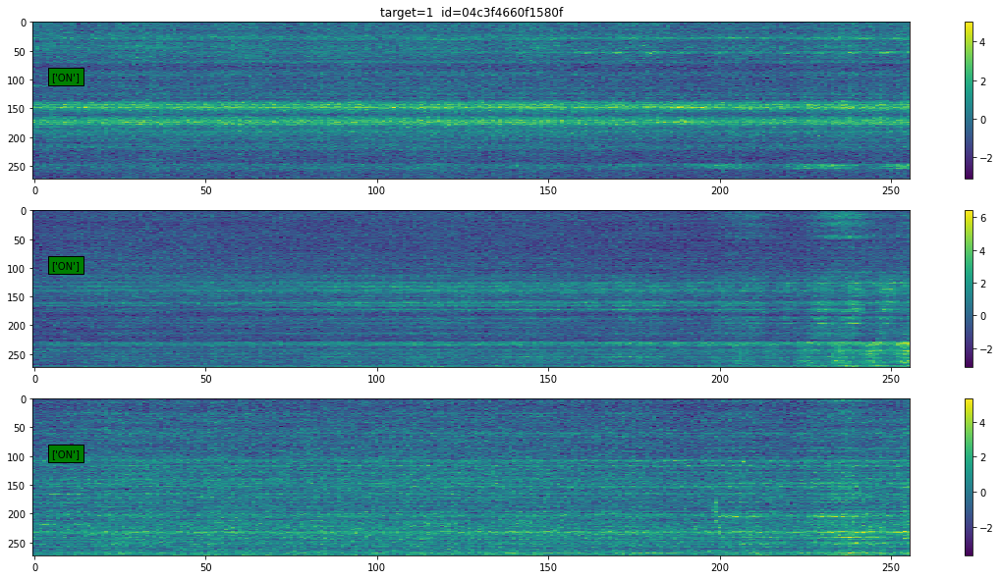

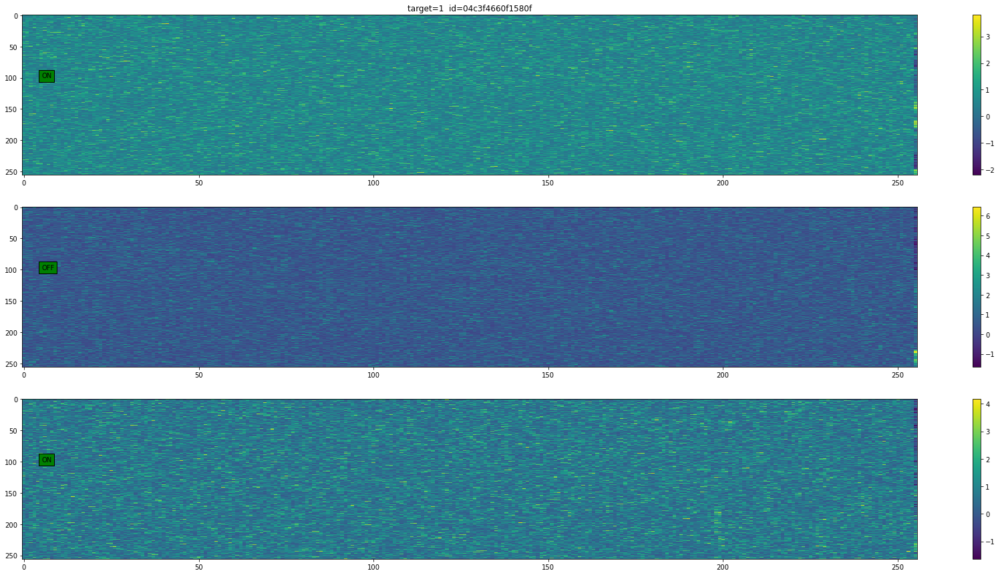

In [15]:
for i in range(100,110):
    entry = train.loc[train['target'] == 1].iloc[i]
    drawCadence(entry, np.load(entry['img_path']))
    deviation_cadence_horizontal(entry, np.load(entry['img_path']))

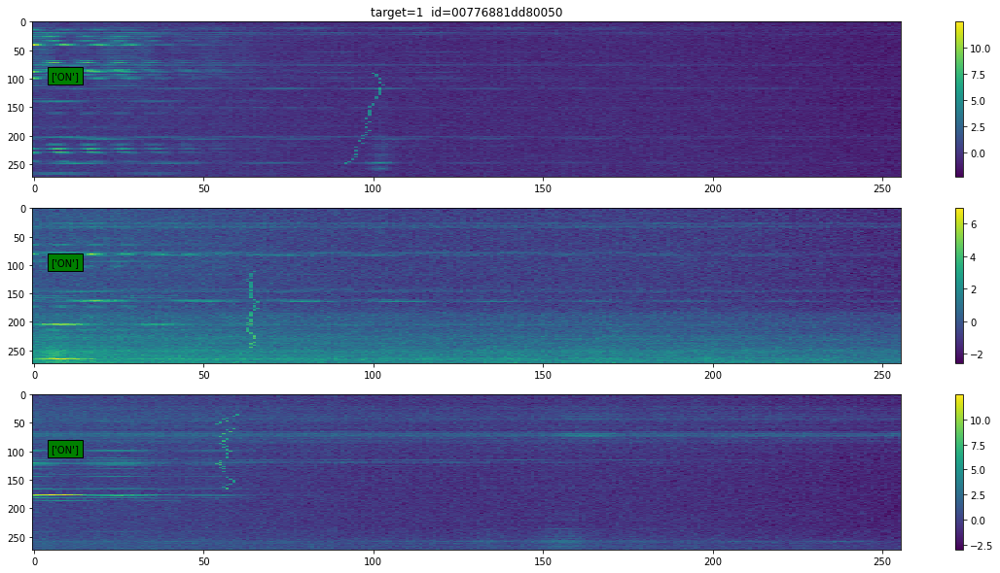

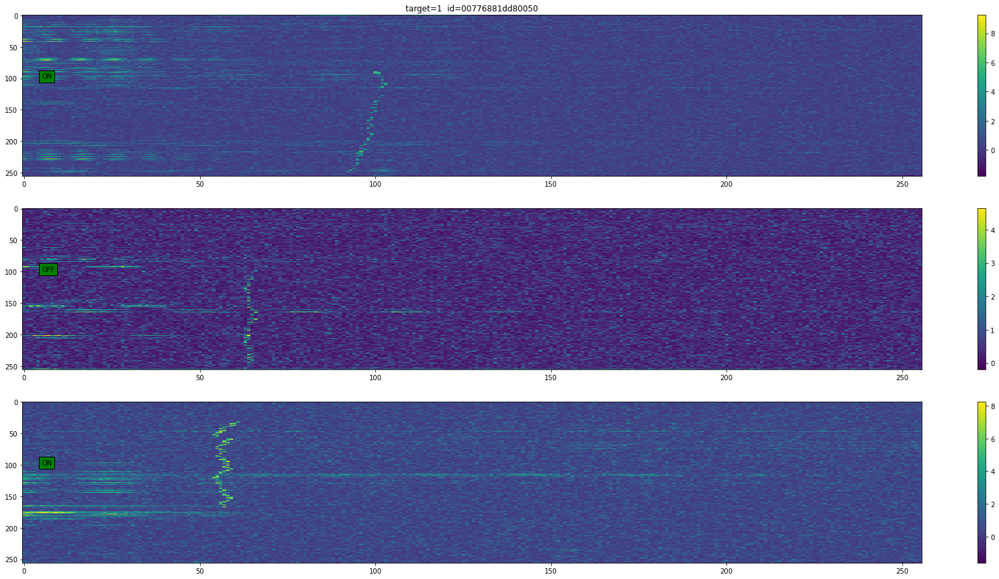

Found clusters in Cadence 0
[[(12, 2), (10, 4), (8, 6), (6, 8)], [(97, 2), (95, 4), (93, 6), (91, 8)], [(172, 2), (170, 4), (168, 6), (166, 8)], [(99, 4), (103, 2), (101, 4), (103, 4)], [(207, 4), (205, 6), (203, 8), (201, 10)], [(216, 5), (214, 7), (212, 9), (210, 11)], [(47, 6), (45, 8), (43, 10), (47, 8), (45, 10)], [(7, 7), (9, 7), (7, 9), (5, 11), (5, 13), (7, 11)], [(45, 8), (43, 10), (47, 8), (45, 10)], [(96, 8), (94, 10), (92, 12), (94, 12), (96, 12), (98, 8), (96, 10), (98, 12)], [(187, 8), (185, 10), (187, 10), (191, 8), (189, 10)], [(7, 9), (5, 11), (5, 13), (7, 11)], [(94, 10), (92, 12), (94, 12), (96, 12), (98, 8), (96, 10), (98, 12)], [(124, 10), (122, 12), (120, 14), (118, 16)], [(180, 10), (184, 10), (182, 12), (180, 14)], [(17, 11), (15, 13), (13, 15), (15, 15)], [(119, 11), (117, 13), (123, 9), (123, 11), (121, 13)], [(181, 12), (179, 14), (177, 16), (185, 12)], [(100, 13), (104, 11), (102, 13), (102, 15)], [(218, 13), (216, 15), (214, 17), (214, 19)], [(218, 13), (21

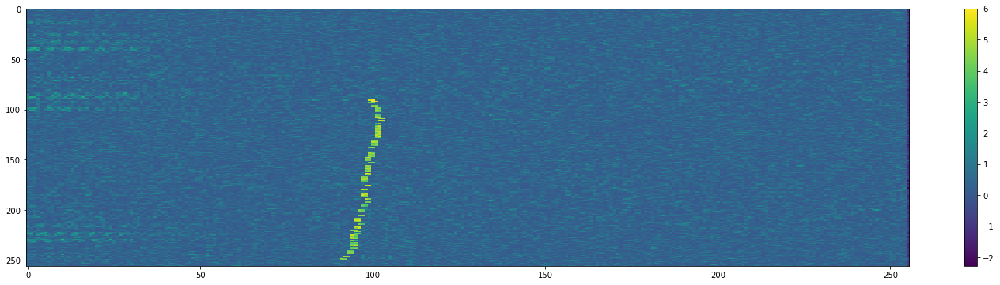

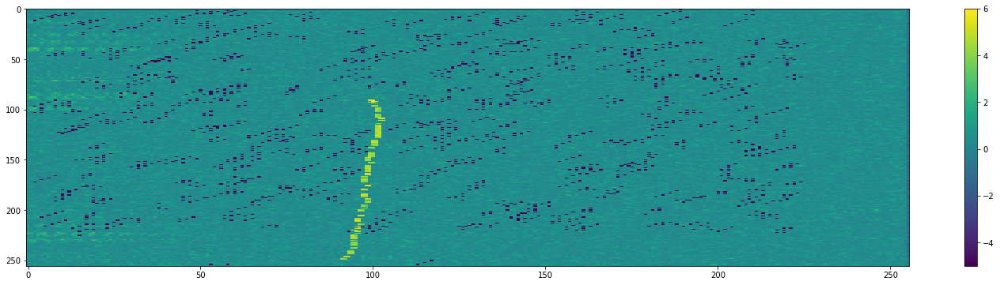

In [17]:
#cluster in deviation_cadence_horizontal
entry = train.loc[train['target'] == 1].iloc[7]
reading = np.load(entry['img_path'])
drawCadence(entry, reading)
deviation_cadence(entry, reading)
chosen_cadence = 0
cadence = reading[chosen_cadence][0:256]
cadence = cadence.T
for j in range(len(cadence)-1):
    for k in range(len(cadence[j])):
        cadence[j][k] = abs(cadence[j][k] - cadence[j+1][k])
cadence = cadence.T
figure = plt.figure(figsize=(25, 6))
plt.imshow(cadence.astype(float), interpolation='nearest', aspect='auto')
plt.colorbar()

def fillCluster(cadence, listOfClusters):
    for i in range(len(listOfClusters)):
        for j in range(len(listOfClusters[i])):
            cadence[listOfClusters[i][j][0]][listOfClusters[i][j][1]] = -5

listOfClusters = []
for i in range(len(cadence)-1):
    for j in range(len(cadence[i])-1):
        currentCluster = []
        cluster(cadence, currentCluster, j, i, 0.05, 2)
        if len(currentCluster) > 3:
            listOfClusters.append(currentCluster)
print('Found clusters in Cadence '+str(chosen_cadence))
print(listOfClusters)
fillCluster(cadence, listOfClusters)

figure = plt.figure(figsize=(25, 6))
plt.imshow(cadence.astype(float), interpolation='nearest', aspect='auto')
plt.colorbar()

Existierende Notebooks verwenden, CNNs, EfficientNet, ResNet18d BaseLine


histogramm über farben

eindeutige ergebnisse über klassen zuordnen

beide ableitungen vergleichen

std normalization etc. vergleichen
